In [1]:
!pip install roboflow

from roboflow import Roboflow

rf = Roboflow(api_key="B1cik3f3QkUSDyecNL9e")
project = rf.workspace("my-ai").project("face-attribute")
dataset = project.version(17).download("multiclass")



     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.0/69.0 kB 1.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 6.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 7.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 4.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 17.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 8.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.5/77.5 kB 9.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 6.8 MB/s eta 0:00:00
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.1.1
    Uninstalling pyparsing-3.1.1:
      Successfully uninstalled pyparsing-3.1.1
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.8.1.78
    Uninstalling opencv-python-headless-4.8.1.78:
      Successfully uninstalle

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Face-Attribute-15 in multiclass:: 100%|██████████| 17357/17357 [00:03<00:00, 5316.35it/s]


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Face-Attribute-17 in multiclass:: 100%|██████████| 12300/12300 [00:02<00:00, 4207.27it/s]


In [3]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [9]:
import pandas as pd
import numpy as np
import keras
import tensorflow as tf
from tensorflow.keras import layers, models, optimizers, metrics
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.models import load_model
from tensorflow.keras.metrics import AUC, Precision, Recall
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import CSVLogger


In [13]:
# Đọc dữ liệu từ CSV
train_df = pd.read_csv("/content/Face-Attribute-15/train/_classes.csv")
valid_df = pd.read_csv("/content/Face-Attribute-15/valid/_classes.csv")

# Đường dẫn tới file CSV
file_path = '/content/Face-Attribute-15/train/_classes.csv'
# Đọc file CSV
df = pd.read_csv(file_path)

# Bỏ cột đầu tiên
df = df.iloc[:, 1:]

# In DataFrame sau khi đã bỏ cột
print(df.head())


# Tạo generators cho dữ liệu
train_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
valid_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

    beard   earrings   female   glass   hat   male
0       0          0        0       0     1      1
1       0          0        0       1     0      1
2       1          0        0       0     0      1
3       0          1        1       0     0      0
4       0          1        1       0     0      0


In [ ]:
train_generator = train_datagen.flow_from_dataframe(
    dataframe=train_df,
    directory="/content/Face-Attribute-15/train",
    x_col="filename",
    y_col=train_df.columns[1:],
    class_mode='raw',
    target_size=(224, 224),
    batch_size=64
)

valid_generator = valid_datagen.flow_from_dataframe(
    dataframe=valid_df,
    directory="/content/Face-Attribute-15/valid",
    x_col="filename",
    y_col=valid_df.columns[1:],
    class_mode='raw',
    target_size=(224, 224),
    batch_size=64
)


Found 15177 validated image filenames.
Found 2174 validated image filenames.


In [ ]:
# Tạo mô hình sử dụng ResNet50 làm base model
base_model = ResNet50(weights='imagenet', include_top=False)
x = base_model.output
x = GlobalAveragePooling2D()(x)

# Thêm một hoặc nhiều lớp Dense
x = Dense(1024, activation='relu')(x)  # Thêm lớp Dense với 1024 nodes
x = Dropout(0.5)(x)  # Thêm Dropout => giảm overfitting
x = Dense(512, activation='relu')(x)  # Thêm lớp Dense 512 nodes

# Thêm lớp Dense cho phân loại đa nhãn
predictions = Dense(6, activation='sigmoid')(x)

model = Model(inputs=base_model.input, outputs=predictions)

optimizer = keras.optimizers.Adam(learning_rate=1e-3)
 # Define the metrics
precision = metrics.Precision(name='precision')
recall = metrics.Recall(name='recall')
auc = metrics.AUC(name='auc')

save_freq = n_batches_per_epoch * 10
# Biên dịch mô hình
model.compile(
        optimizer=optimizer,
        loss="binary_crossentropy",
        metrics=[metrics.BinaryAccuracy(name='accuracy'), precision, recall, auc]
)

# Callback Early Stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=5)  # Dừng huấn luyện nếu val_loss không cải thiện sau 5 epochs

# Callback để lưu mô hình với val_loss tốt nhất, val_auc tốt nhất
checkpoint_val = ModelCheckpoint('/content/drive/MyDrive/resnet/best_val.h5',
                                 save_best_only=True, monitor='val_loss', mode='min')
checkpoint_auc = ModelCheckpoint('/content/drive/MyDrive/resnet/best_auc.h5',
                                 save_best_only=True, monitor='val_auc', mode='max')
csv_logger = CSVLogger('/content/drive/MyDrive/resnet/training_log.csv', append=True)


# Huấn luyện mô hình với cả hai callback
history = model.fit(train_generator, validation_data=valid_generator, epochs=100,
                    callbacks=([checkpoint_val, checkpoint_auc,  csv_logger]))


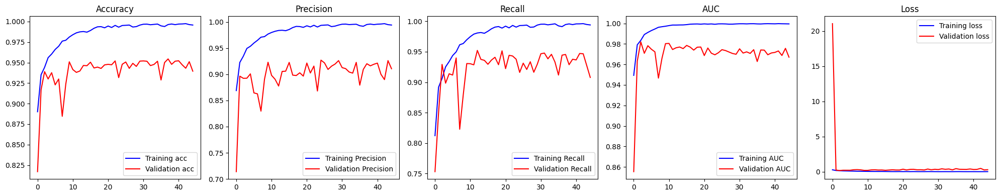

In [5]:
import pandas as pd
import matplotlib.pyplot as plt

# Đọc dữ liệu từ tệp CSV vào một DataFrame
data = pd.read_csv('/content/drive/MyDrive/resnet_classification/training_logg.csv')

# Lấy dữ liệu từ DataFrame
epochs = data['epoch']
acc = data['accuracy']
val_acc = data['val_accuracy']
precision = data['precision']
val_precision = data['val_precision']
recall = data['recall']
val_recall = data['val_recall']
auc = data['auc']
val_auc = data['val_auc']
loss = data['loss']
val_loss = data['val_loss']

# Tạo một hàng có 5 đồ thị
plt.figure(figsize=(20, 4))

# Đồ thị Accuracy
plt.subplot(1, 5, 1)
plt.plot(epochs, acc, 'b', label='Training acc')
plt.plot(epochs, val_acc, 'r', label='Validation acc')
plt.title('Accuracy')
plt.legend()


# Đồ thị Precision
plt.subplot(1, 5, 2)
plt.plot(epochs, precision, 'b', label='Training Precision')
plt.plot(epochs, val_precision, 'r', label='Validation Precision')
plt.title('Precision')
plt.legend()

# Đồ thị Recall
plt.subplot(1, 5, 3)
plt.plot(epochs, recall, 'b', label='Training Recall')
plt.plot(epochs, val_recall, 'r', label='Validation Recall')
plt.title('Recall')
plt.legend()

# Đồ thị AUC
plt.subplot(1, 5, 4)
plt.plot(epochs, auc, 'b', label='Training AUC')
plt.plot(epochs, val_auc, 'r', label='Validation AUC')
plt.title('AUC')
plt.legend()

# Đồ thị Loss
plt.subplot(1, 5, 5)
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Loss')
plt.legend()

plt.tight_layout()
plt.show()


1/1 [==============================] - 1s 1s/step
Predicted labels for eyeglasses917.jpg: ['glass', 'male']


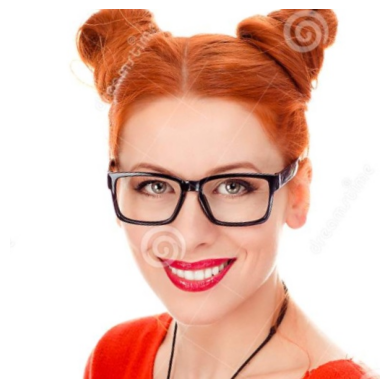

1/1 [==============================] - 0s 312ms/step
Predicted labels for eyeglasses923.jpg: ['glass', 'hat', 'male']


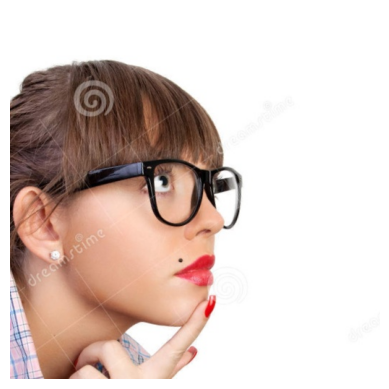

1/1 [==============================] - 0s 327ms/step
Predicted labels for eyeglasses915.jpg: ['female', 'glass']


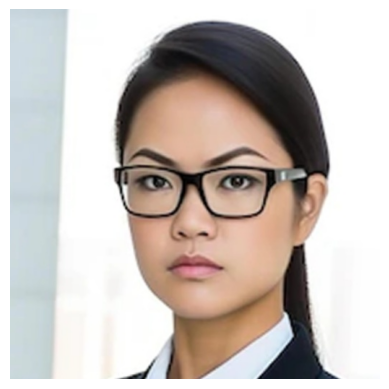

1/1 [==============================] - 0s 358ms/step
Predicted labels for eyeglasses924.jpg: ['female', 'glass']


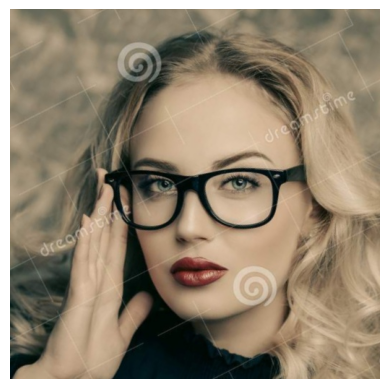

1/1 [==============================] - 0s 330ms/step
Predicted labels for eyeglasses928.jpg: ['glass', 'male']


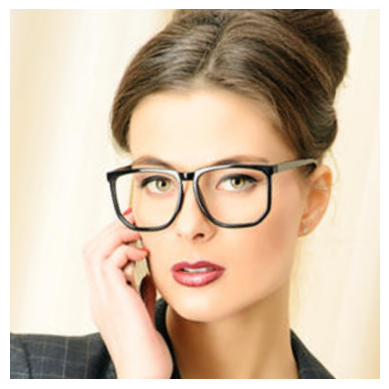

1/1 [==============================] - 0s 335ms/step
Predicted labels for eyeglasses925.jpg: ['female', 'glass']


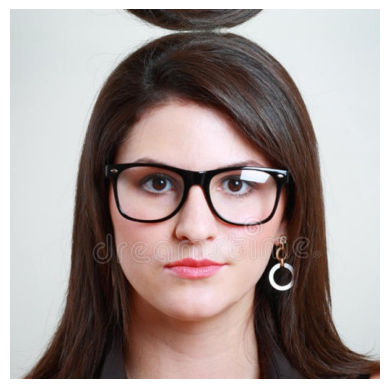

1/1 [==============================] - 0s 360ms/step
Predicted labels for eyeglasses929.jpg: ['glass', 'male']


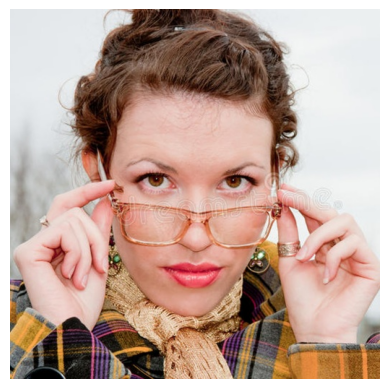

1/1 [==============================] - 0s 373ms/step
Predicted labels for eyeglasses932.jpg: ['female', 'glass']


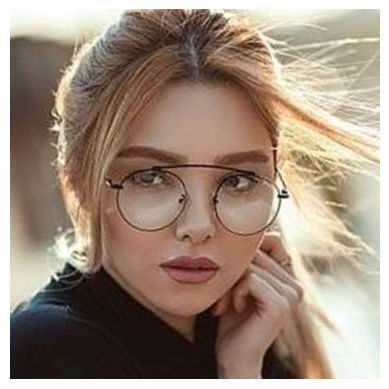

1/1 [==============================] - 0s 390ms/step
Predicted labels for eyeglasses934.jpg: ['female', 'glass']


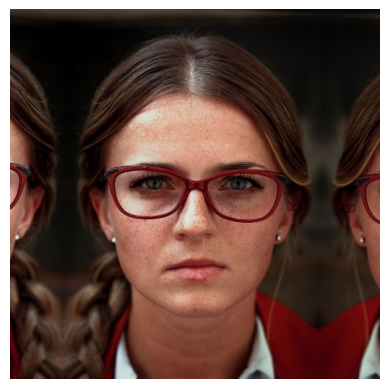

1/1 [==============================] - 0s 215ms/step
Predicted labels for eyeglasses936.jpg: ['female', 'glass']


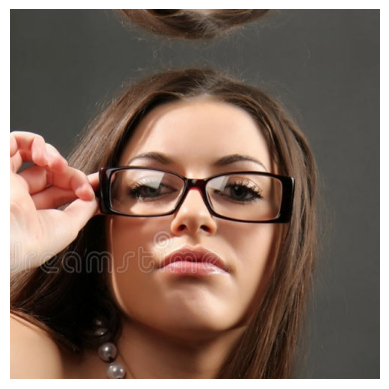

1/1 [==============================] - 0s 205ms/step
Predicted labels for eyeglasses931.jpg: ['glass', 'male']


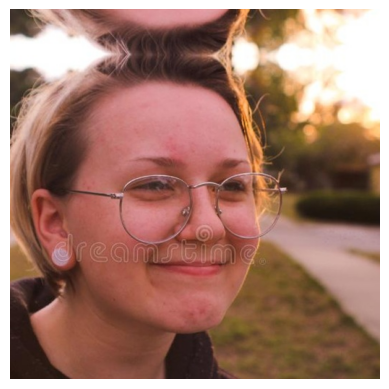

1/1 [==============================] - 0s 220ms/step
Predicted labels for eyeglasses933.jpg: ['female', 'glass']


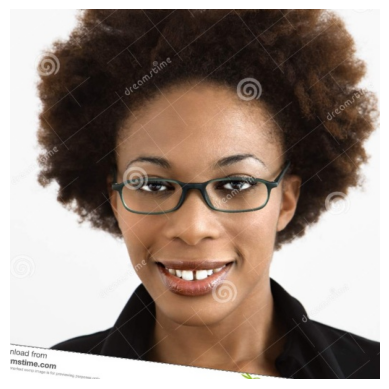

1/1 [==============================] - 0s 210ms/step
Predicted labels for eyeglasses930.jpg: ['glass', 'male']


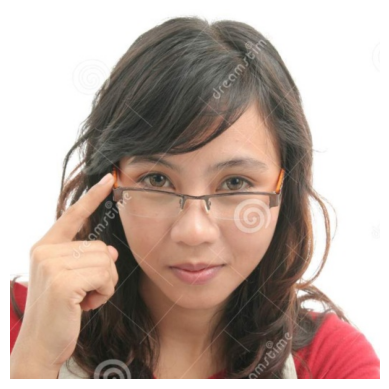

1/1 [==============================] - 0s 210ms/step
Predicted labels for eyeglasses926.jpg: ['female', 'glass']


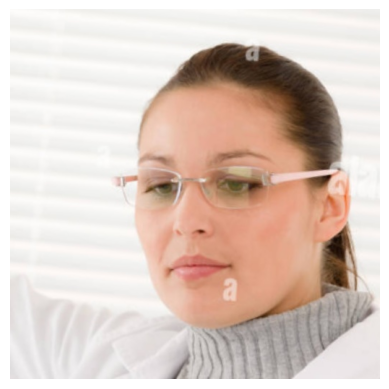

1/1 [==============================] - 0s 196ms/step
Predicted labels for eyeglasses935.jpg: ['female', 'glass']


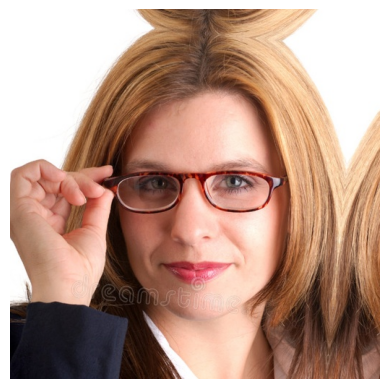

1/1 [==============================] - 0s 257ms/step
Predicted labels for eyeglasses927.jpg: ['female', 'glass']


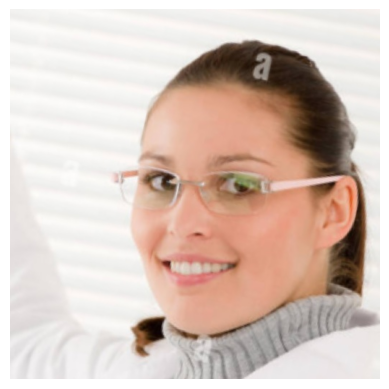

1/1 [==============================] - 0s 200ms/step
Predicted labels for eyeglasses945.jpg: ['female', 'glass']


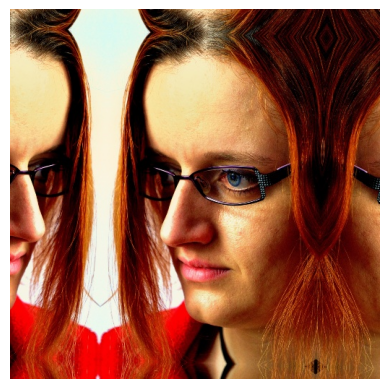

1/1 [==============================] - 0s 219ms/step
Predicted labels for eyeglasses944.jpg: ['female', 'glass']


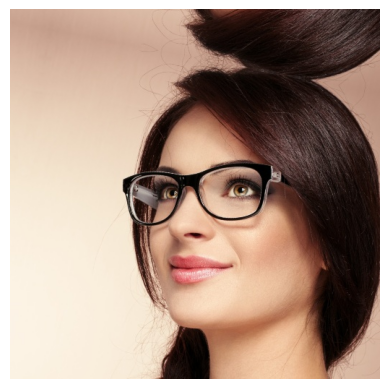

1/1 [==============================] - 0s 227ms/step
Predicted labels for eyeglasses899.jpg: ['glass', 'hat', 'male']


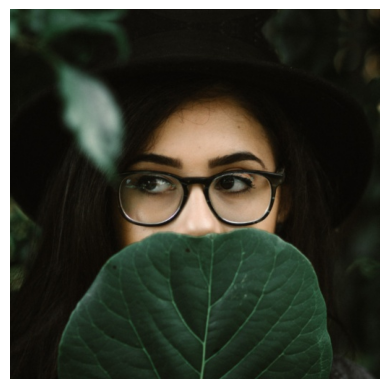

1/1 [==============================] - 0s 213ms/step
Predicted labels for eyeglasses937.jpg: ['female', 'glass']


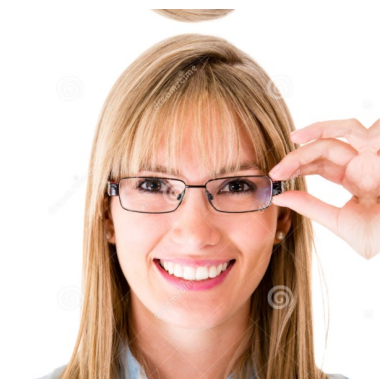

1/1 [==============================] - 0s 221ms/step
Predicted labels for eyeglasses940.jpg: ['glass', 'male']


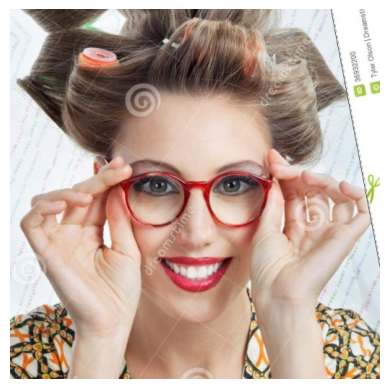

1/1 [==============================] - 0s 230ms/step
Predicted labels for eyeglasses942.jpg: ['female', 'glass']


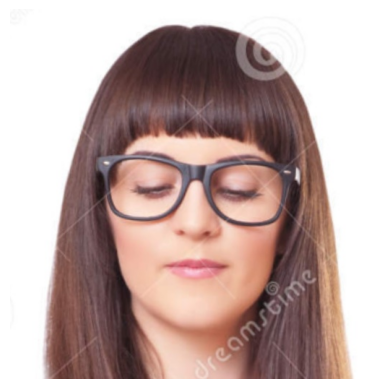

1/1 [==============================] - 0s 286ms/step
Predicted labels for eyeglasses941.jpg: ['female', 'glass']


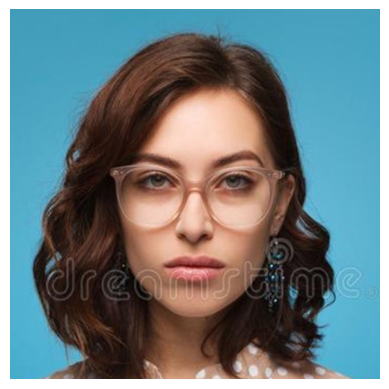

1/1 [==============================] - 0s 231ms/step
Predicted labels for eyeglasses943.jpg: ['female', 'glass']


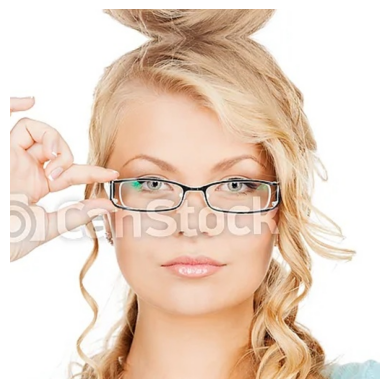

1/1 [==============================] - 0s 217ms/step
Predicted labels for eyeglasses946.jpg: ['female', 'glass']


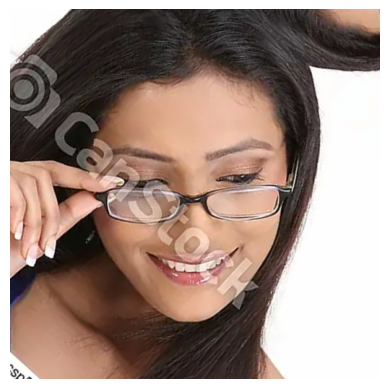

1/1 [==============================] - 0s 388ms/step
Predicted labels for eyeglasses938.jpg: ['female', 'glass']


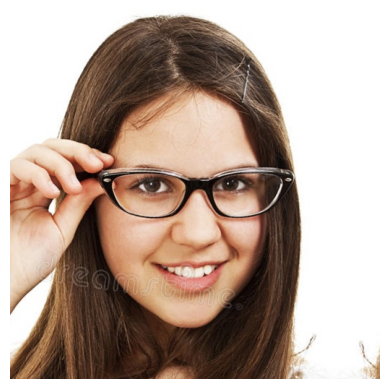

1/1 [==============================] - 0s 425ms/step
Predicted labels for eyeglasses939.jpg: ['glass', 'male']


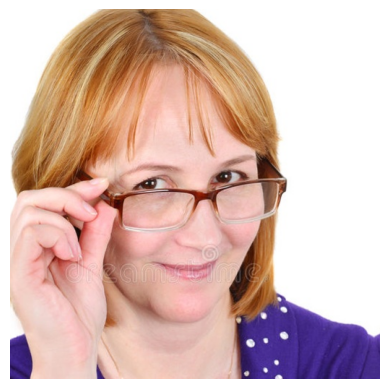

1/1 [==============================] - 0s 344ms/step
Predicted labels for eyeglasses900.jpg: ['female', 'glass']


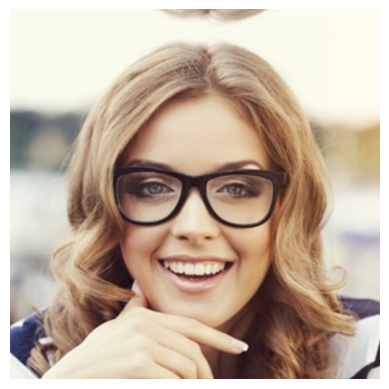

1/1 [==============================] - 0s 442ms/step
Predicted labels for eyeglasses949.jpg: ['female', 'glass']


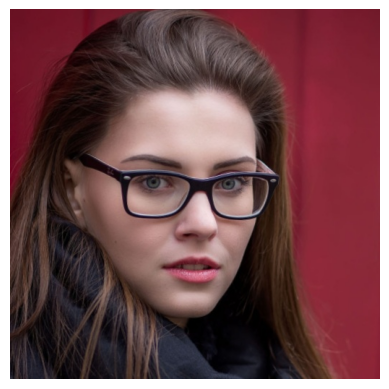

1/1 [==============================] - 0s 381ms/step
Predicted labels for eyeglasses954.jpg: ['female', 'glass']


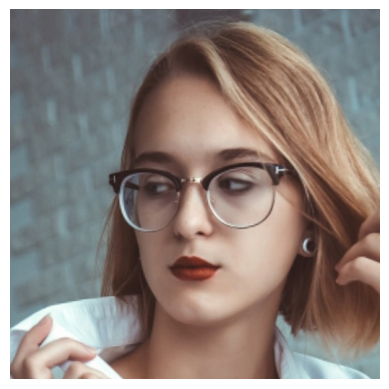

1/1 [==============================] - 0s 361ms/step
Predicted labels for eyeglasses953.jpg: ['female', 'glass']


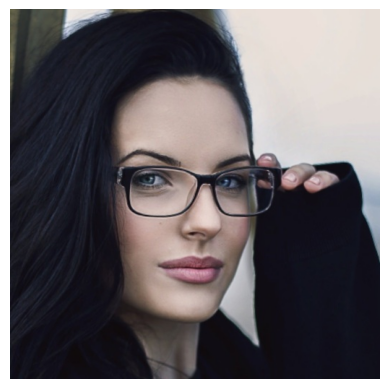

1/1 [==============================] - 0s 386ms/step
Predicted labels for eyeglasses958.jpg: ['female', 'glass']


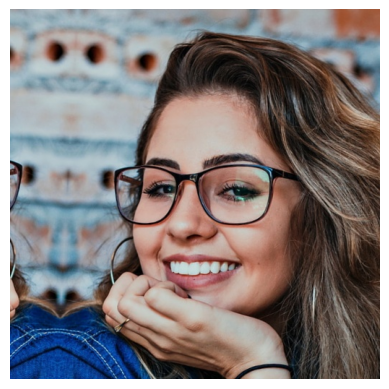

1/1 [==============================] - 0s 287ms/step
Predicted labels for eyeglasses955.jpg: ['glass', 'hat', 'male']


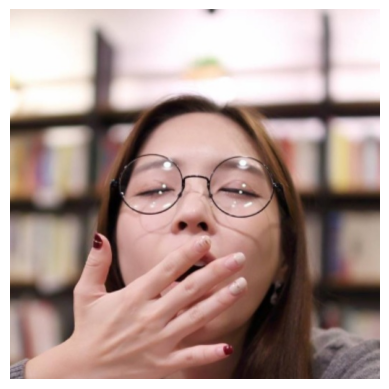

1/1 [==============================] - 0s 298ms/step
Predicted labels for eyeglasses959.jpg: ['female', 'glass']


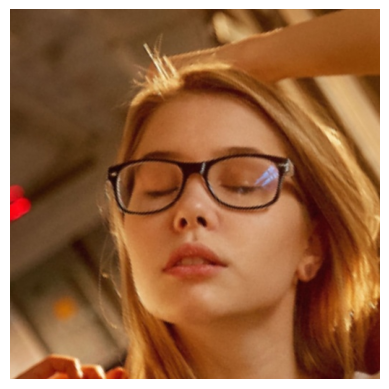

1/1 [==============================] - 0s 337ms/step
Predicted labels for eyeglasses960.jpg: ['female', 'glass']


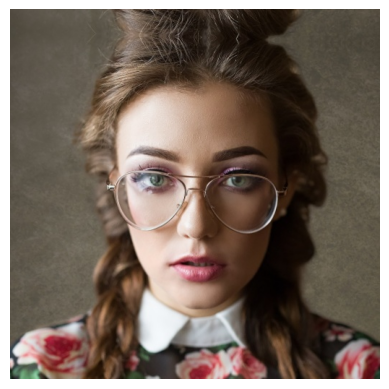

1/1 [==============================] - 0s 300ms/step
Predicted labels for eyeglasses957.jpg: ['female', 'glass']


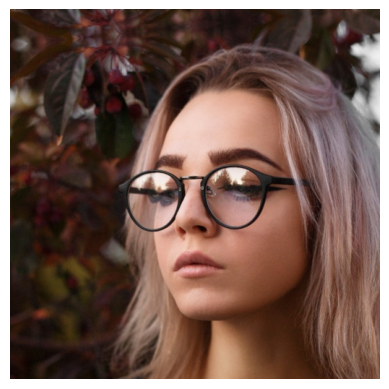

1/1 [==============================] - 0s 294ms/step
Predicted labels for eyeglasses951.jpg: ['female', 'glass']


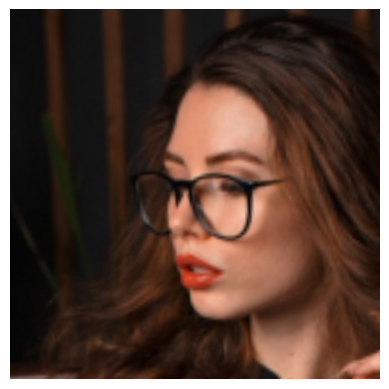

1/1 [==============================] - 0s 263ms/step
Predicted labels for eyeglasses956.jpg: ['glass', 'male']


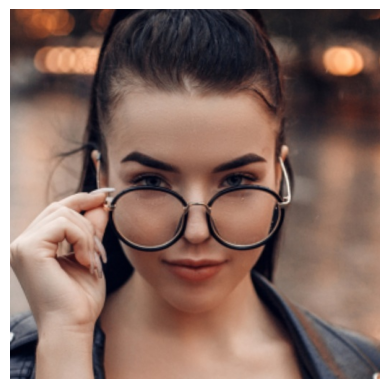

1/1 [==============================] - 0s 365ms/step
Predicted labels for eyeglasses947.jpg: ['female', 'glass']


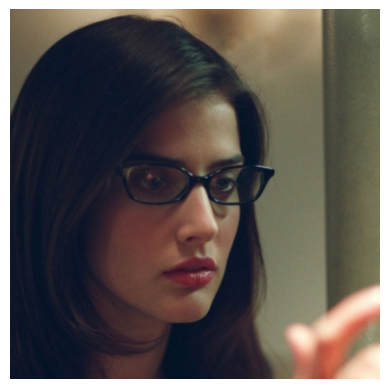

1/1 [==============================] - 0s 346ms/step
Predicted labels for eyeglasses952.jpg: ['female', 'glass']


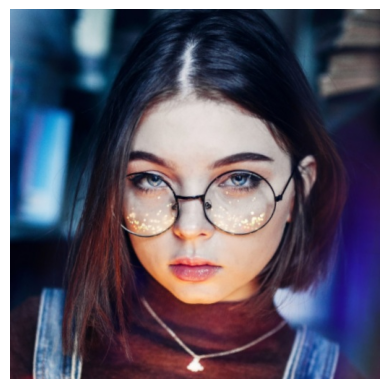

1/1 [==============================] - 0s 339ms/step
Predicted labels for eyeglasses948.jpg: ['female', 'glass']


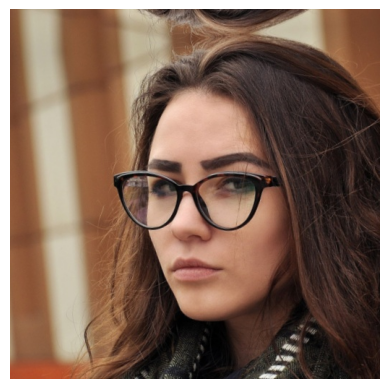

1/1 [==============================] - 0s 313ms/step
Predicted labels for eyeglasses966.jpg: ['glass', 'male']


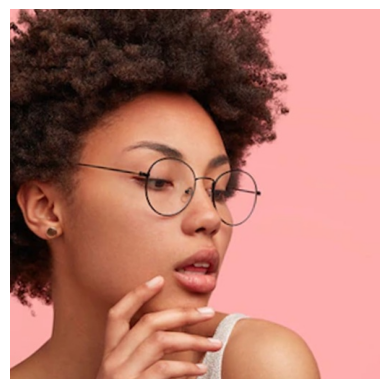

1/1 [==============================] - 0s 354ms/step
Predicted labels for eyeglasses971.jpg: ['glass', 'male']


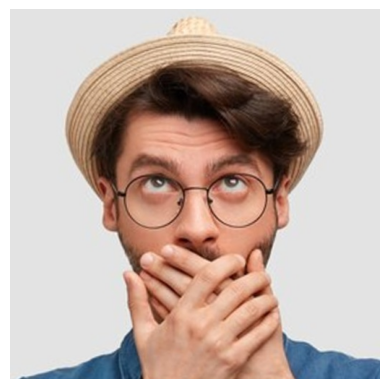

1/1 [==============================] - 0s 362ms/step
Predicted labels for eyeglasses969.jpg: ['glass', 'male']


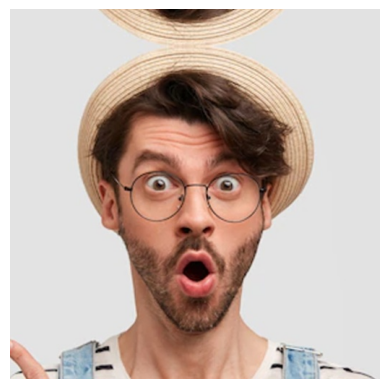

1/1 [==============================] - 0s 357ms/step
Predicted labels for eyeglasses967.jpg: ['glass', 'male']


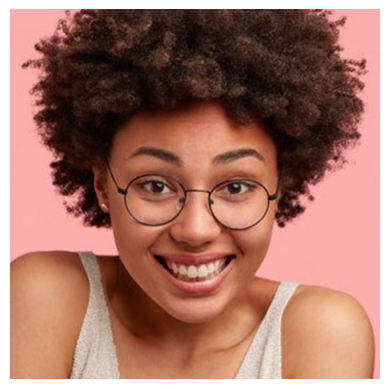

1/1 [==============================] - 0s 370ms/step
Predicted labels for eyeglasses970.jpg: ['glass', 'male']


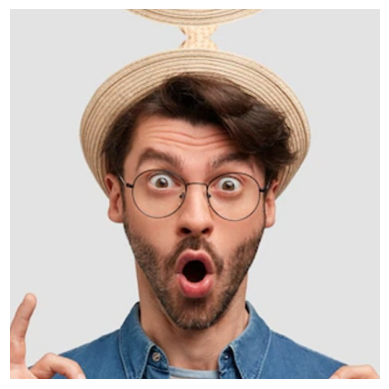

1/1 [==============================] - 0s 370ms/step
Predicted labels for eyeglasses963.jpg: ['beard', 'male']


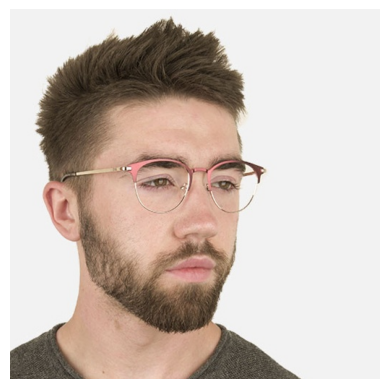

1/1 [==============================] - 0s 488ms/step
Predicted labels for eyeglasses968.jpg: ['beard', 'glass', 'male']


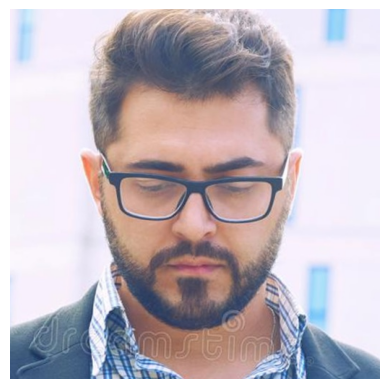

1/1 [==============================] - 0s 373ms/step
Predicted labels for eyeglasses973.jpg: ['female', 'glass']


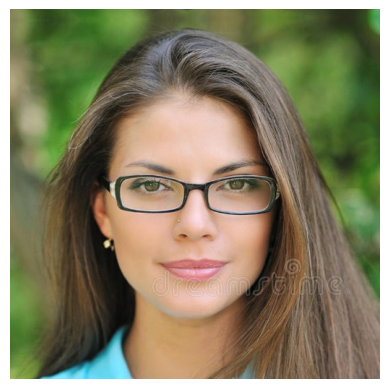

1/1 [==============================] - 0s 360ms/step
Predicted labels for eyeglasses972.jpg: ['female', 'glass']


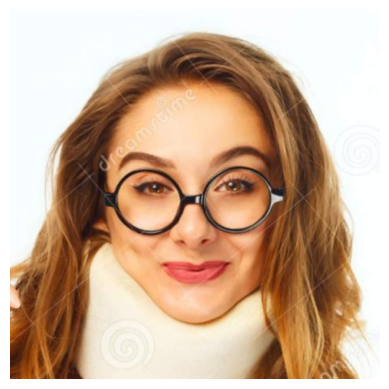

1/1 [==============================] - 0s 342ms/step
Predicted labels for eyeglasses965.jpg: ['glass', 'male']


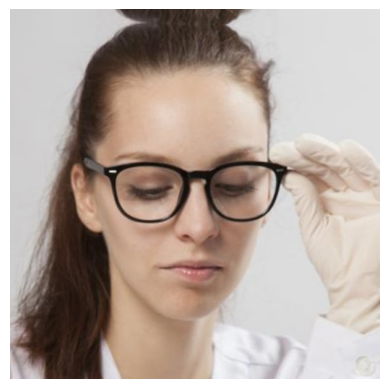

1/1 [==============================] - 0s 440ms/step
Predicted labels for eyeglasses974.jpg: ['female', 'hat']


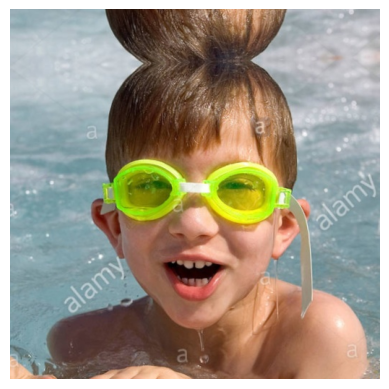

1/1 [==============================] - 0s 420ms/step
Predicted labels for eyeglasses975.jpg: ['glass', 'male']


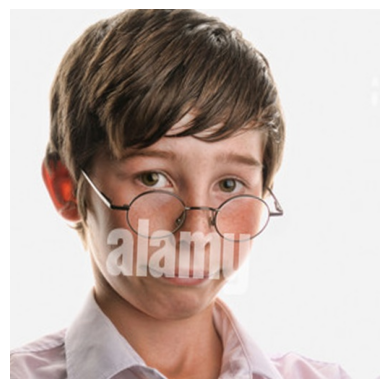

1/1 [==============================] - 0s 379ms/step
Predicted labels for eyeglasses981.jpg: ['glass', 'male']


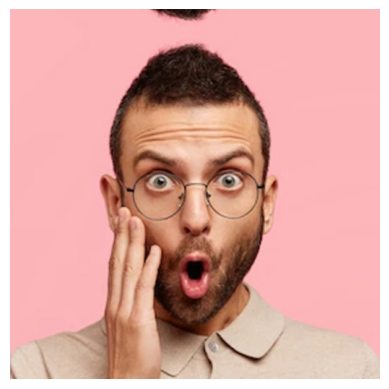

1/1 [==============================] - 0s 341ms/step
Predicted labels for eyeglasses982.jpg: ['glass', 'male']


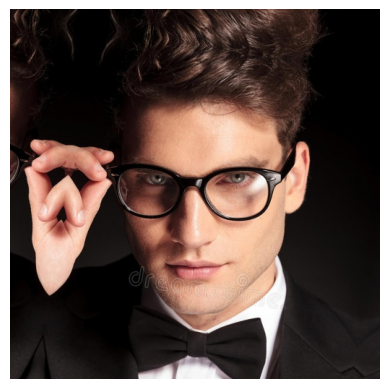

1/1 [==============================] - 0s 329ms/step
Predicted labels for eyeglasses983.jpg: ['glass', 'male']


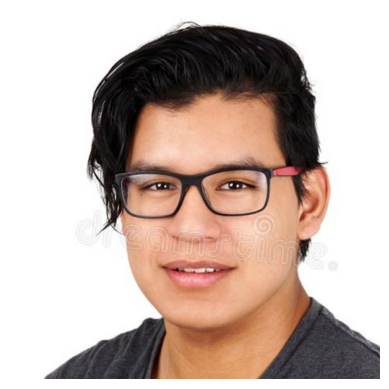

1/1 [==============================] - 0s 342ms/step
Predicted labels for eyeglasses978.jpg: ['female', 'glass', 'hat']


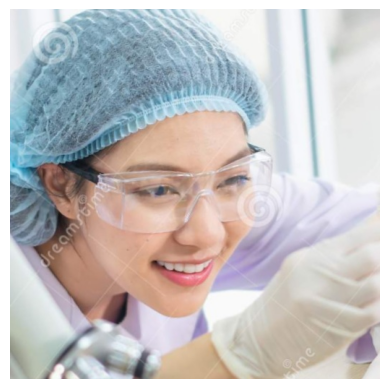

1/1 [==============================] - 0s 323ms/step
Predicted labels for eyeglasses979.jpg: ['glass', 'male']


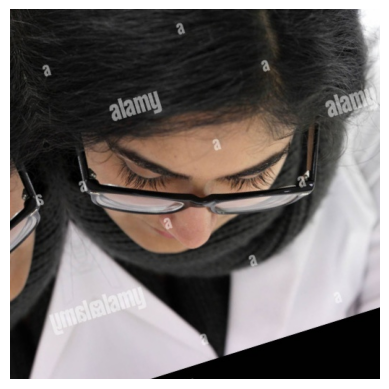

1/1 [==============================] - 0s 320ms/step
Predicted labels for eyeglasses984.jpg: ['beard', 'glass', 'male']


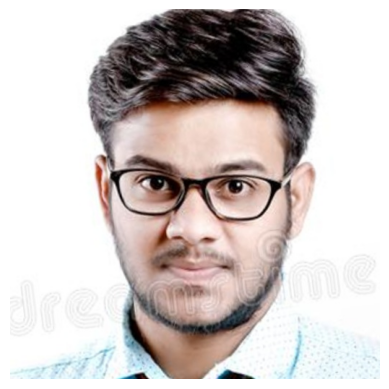

1/1 [==============================] - 0s 336ms/step
Predicted labels for eyeglasses976.jpg: ['glass', 'male']


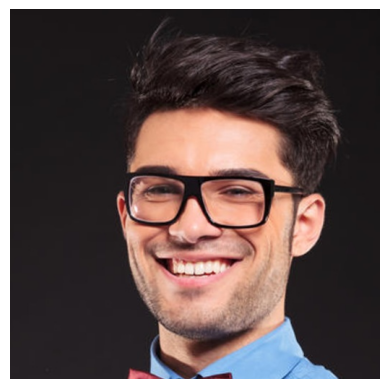

1/1 [==============================] - 0s 334ms/step
Predicted labels for eyeglasses985.jpg: ['glass', 'male']


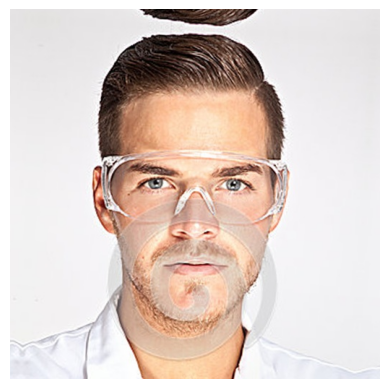

1/1 [==============================] - 0s 348ms/step
Predicted labels for eyeglasses980.jpg: ['glass', 'male']


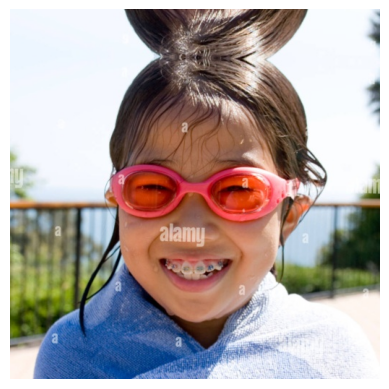

1/1 [==============================] - 0s 352ms/step
Predicted labels for eyeglasses977.jpg: ['hat', 'male']


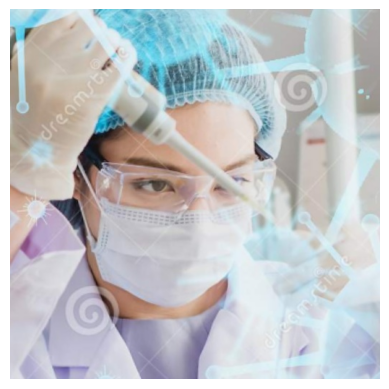

1/1 [==============================] - 0s 338ms/step
Predicted labels for eyeglasses986.jpg: ['glass', 'hat', 'male']


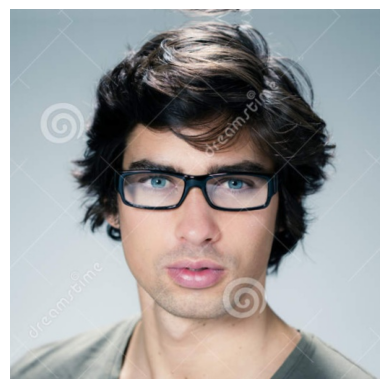

1/1 [==============================] - 0s 334ms/step
Predicted labels for eyeglasses991.jpg: ['glass', 'male']


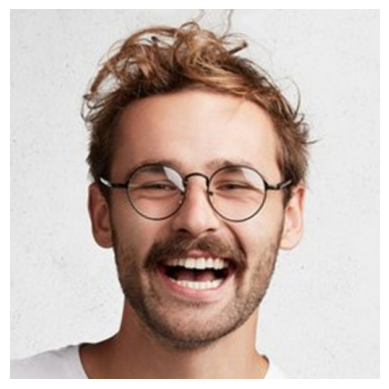

1/1 [==============================] - 0s 361ms/step
Predicted labels for eyeglasses989.jpg: ['beard', 'glass', 'male']


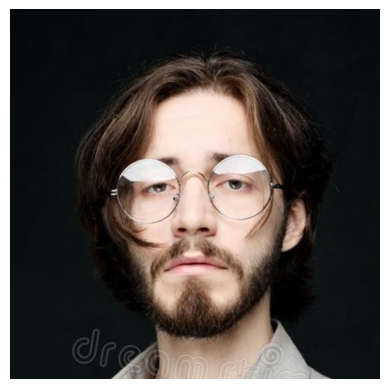

1/1 [==============================] - 0s 412ms/step
Predicted labels for eyeglasses996.jpg: ['glass', 'male']


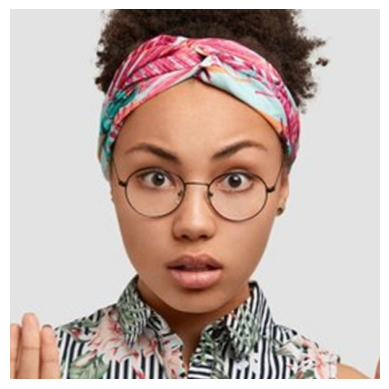

1/1 [==============================] - 0s 407ms/step
Predicted labels for eyeglasses992.jpg: ['beard', 'glass', 'male']


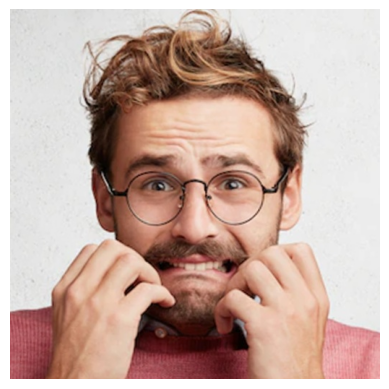

1/1 [==============================] - 0s 359ms/step
Predicted labels for eyeglasses993.jpg: ['glass', 'male']


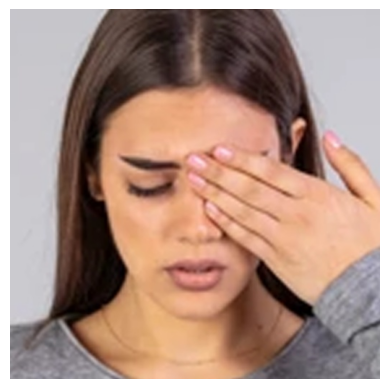

1/1 [==============================] - 0s 430ms/step
Predicted labels for eyeglasses987.jpg: ['glass', 'male']


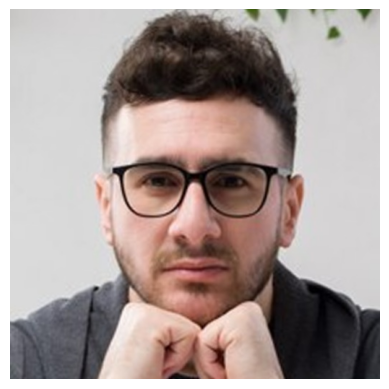

1/1 [==============================] - 0s 372ms/step
Predicted labels for eyeglasses988.jpg: ['glass', 'male']


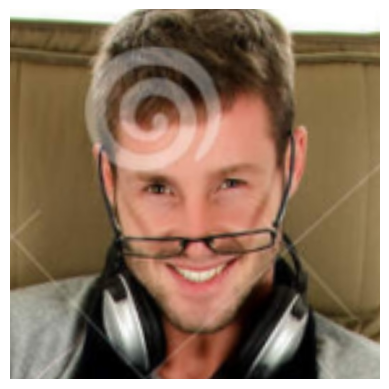

1/1 [==============================] - 0s 345ms/step
Predicted labels for eyeglasses990.jpg: ['glass', 'male']


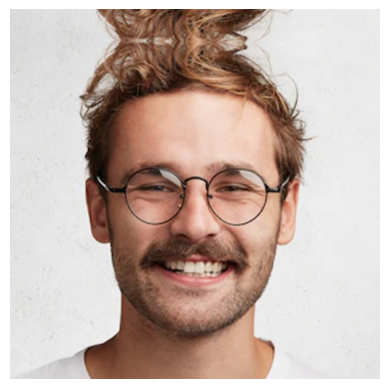

1/1 [==============================] - 0s 408ms/step
Predicted labels for eyeglasses997.jpg: ['glass', 'male']


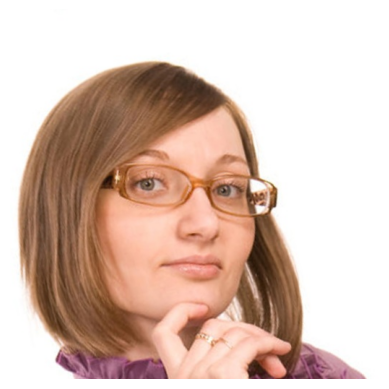

1/1 [==============================] - 0s 442ms/step
Predicted labels for eyeglasses994.jpg: ['female', 'glass']


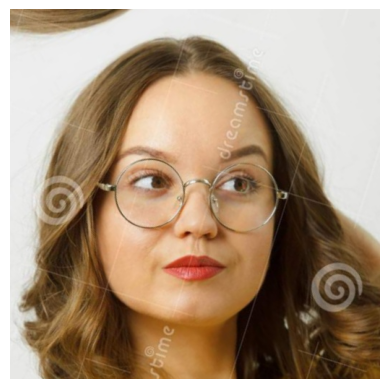

1/1 [==============================] - 0s 466ms/step
Predicted labels for eyeglasses995.jpg: ['hat', 'male']


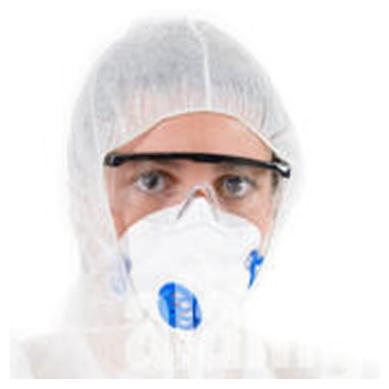

1/1 [==============================] - 0s 329ms/step
Predicted labels for eyeglasses998.jpg: ['female', 'glass']


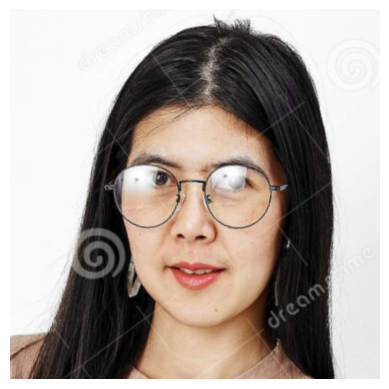

1/1 [==============================] - 0s 358ms/step
Predicted labels for eyeglasses913.jpg: ['female', 'glass']


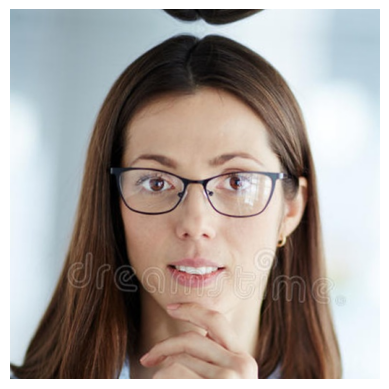

1/1 [==============================] - 0s 346ms/step
Predicted labels for eyeglasses918.jpg: ['female', 'glass']


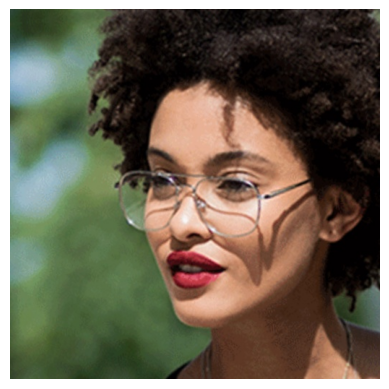

1/1 [==============================] - 0s 351ms/step
Predicted labels for eyeglasses910.jpg: ['female', 'glass']


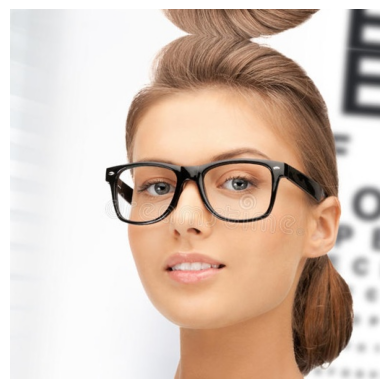

1/1 [==============================] - 0s 361ms/step
Predicted labels for eyeglasses921.jpg: ['female', 'glass']


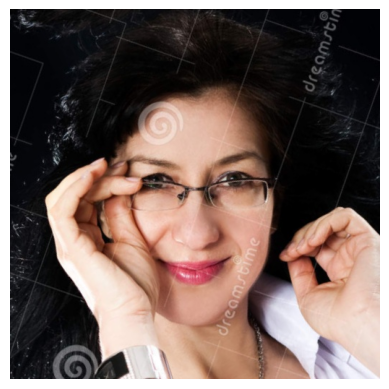

1/1 [==============================] - 0s 382ms/step
Predicted labels for eyeglasses922.jpg: ['female', 'glass']


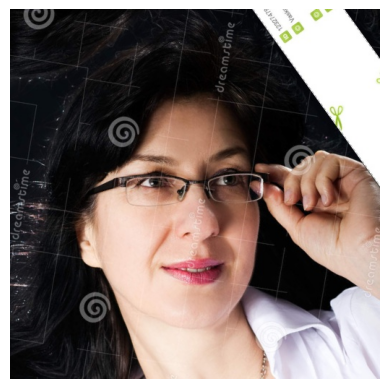

1/1 [==============================] - 0s 448ms/step
Predicted labels for eyeglasses912.jpg: ['female', 'glass']


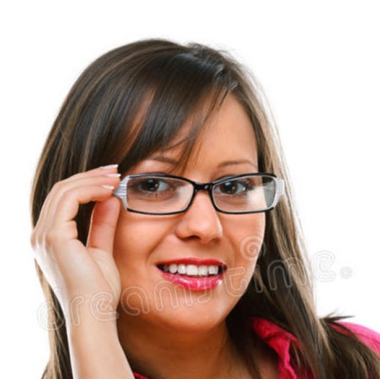

1/1 [==============================] - 0s 347ms/step
Predicted labels for eyeglasses914.jpg: ['female', 'glass']


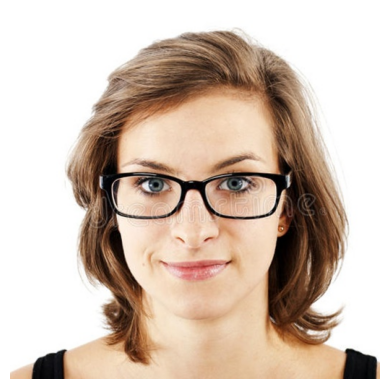

1/1 [==============================] - 0s 401ms/step
Predicted labels for eyeglasses916.jpg: ['glass', 'male']


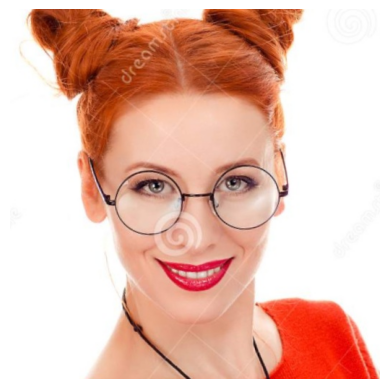

1/1 [==============================] - 0s 436ms/step
Predicted labels for eyeglasses920.jpg: ['glass', 'male']


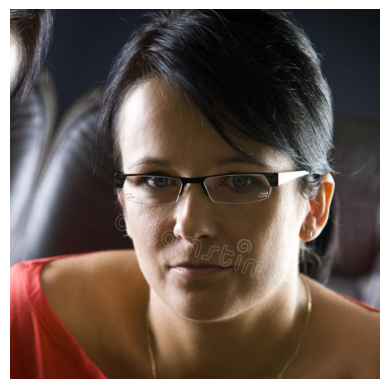

1/1 [==============================] - 0s 400ms/step
Predicted labels for eyeglasses919.jpg: ['female', 'glass']


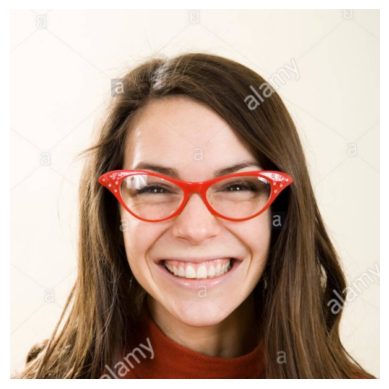

1/1 [==============================] - 0s 390ms/step
Predicted labels for eyeglasses911.jpg: ['female', 'glass']


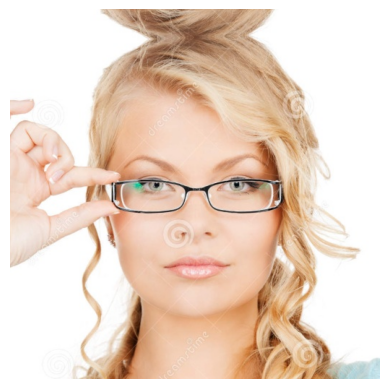

In [8]:
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image


# Hàm xử lý hình ảnh mới sử dụng preprocess_input của ResNet50
def preprocess_image(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = preprocess_input(img_array)  # Sử dụng hàm xử lý ảnh chuẩn của ResNet50
    return img_array

# Hàm dự đoán với ngưỡng
def predict_with_threshold(model, img_array, threshold=0.5):  # Ngưỡng đã được đặt ở đây
    predictions = model.predict(img_array)
    # Đây là một mô hình đa nhãn, chúng ta sẽ áp dụng ngưỡng cho mỗi nhãn
    return [labels[i] for i, prediction in enumerate(predictions[0]) if prediction > threshold]

# Cập nhật đường dẫn của mô hình
model_path = "/content/drive/MyDrive/resnet_classification/best_val.h5"
# Tải mô hình
model = load_model(model_path)

# Danh sách tên nhãn
labels = ['beard', 'earrings', 'female', 'glass', 'hat', 'male']  # Thay 'Nhãn1', 'Nhãn2' bằng tên nhãn thực tế của bạn
# beard   earrings   female   glass   hat   male

#Predict 1 folder ảnh
# Đường dẫn đến folder chứa hình ảnh cần dự đoán
images_folder_path = '/content/drive/MyDrive/Test/Head only'  # Cập nhật đường dẫn này

def display_image_with_labels(img_path):
    img = image.load_img(img_path)
    plt.imshow(img)
    plt.title(f"Predicted labels: {', '.join(predicted_labels)}")
    plt.axis('off')  # Ẩn các trục
    plt.show()

# Duyệt qua folder và thực hiện dự đoán cho mỗi hình ảnh
for img_file in os.listdir(images_folder_path):
    if img_file.lower().endswith(('.png', '.jpg', '.jpeg')):
        img_path = os.path.join(images_folder_path, img_file)
        img_array = preprocess_image(img_path)
        predicted_labels = predict_with_threshold(model, img_array)
        print(f"Predicted labels for {img_file}: {predicted_labels}")
        display_image_with_labels(img_path, predicted_labels)  # Hiển thị ảnh và nhãn


#Predict 1 ảnh cụ thể
# Đường dẫn đến hình ảnh cần kiểm tra
# test_img_path = '/content/Face-Attribute-15/valid/10209684_jpg.rf.f9acca65fe2cddaf15e4f84899229c2d.jpg'
# # Xử lý hình ảnh và dự đoán
# img_array = preprocess_image(test_img_path)
# predicted_labels = predict_with_threshold(model, img_array)

# print(f"Predicted labels for the image: {predicted_labels}")



In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.resnet import preprocess_input
from tensorflow.keras.models import load_model
import pandas as pd

# Đọc file CSV
df = pd.read_csv('/content/Face-Attribute-15/valid/_classes.csv')

# Tạo ImageDataGenerator với hàm preprocess_input của ResNet
test_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

# Tạo test generator từ DataFrame
test_generator = test_datagen.flow_from_dataframe(
    dataframe=df,
    directory='/content/Face-Attribute-15/valid',  # Thay thế bằng đường dẫn thực tế đến thư mục chứa ảnh
    x_col='filename',  # Cột chứa đường dẫn ảnh
    y_col=df.columns[1:],  # Cột chứa nhãn
    class_mode='raw',  # Sử dụng 'raw' để lấy nhãn từ DataFrame
    target_size=(224, 224),
    batch_size=32,
    shuffle=False  # Không trộn dữ liệu để giữ thứ tự

    # dataframe=train_df,
    # directory="/content/Face-Attribute-15/train",
    # x_col="filename",
    # y_col=train_df.columns[1:],
    # class_mode='raw',
    # target_size=(224, 224),
    # batch_size=32
)

# Load mô hình
model = load_model('/content/drive/MyDrive/resnet_classification/best_auc.h5')

# Đánh giá mô hình
loss, accuracy = model.evaluate(test_generator, steps=np.ceil(len(df)/32))

print(f"Loss: {loss}")
print(f"Accuracy: {accuracy}")
